# Time Series Analysis
This notebook is an Exploratory Data Analysis with [these datasets](https://www.kaggle.com/himanigulati/stockone) which contain some indian stock market data on few(about 65) shares, from the month of April to Sept. 
Credits: Himani Gulati https://blog.jovian.ai/time-series-analysis-data-exploration-and-visualization-9dbede5cbb8d

In [18]:
import numpy as np
import pandas as pd
import matplotlib
import matplotlib.pyplot as plt
import seaborn as sns

sns.set_style("darkgrid")
%matplotlib inline

In [19]:
stocks_df = pd.read_csv('./data/stocks_data_2020_till_2020_09_03.csv')
print(len(stocks_df))
stocks_df

2321232


,id,timestamp,open_price,high_price,low_price,close_price,volume,scrip_id
0,1,2020-02-24 09:15:00+05:30,1170.00,1170.00,1149.25,1164.60,104528,2
1,13008,2020-02-24 09:15:00+05:30,318.00,318.00,311.65,312.30,22036,1
2,26015,2020-02-24 09:15:00+05:30,828.95,828.95,825.45,825.85,22222,3
3,39022,2020-02-24 09:15:00+05:30,1672.00,1672.00,1665.00,1667.10,15844,4
4,52029,2020-02-24 09:15:00+05:30,1469.75,1469.75,1463.10,1465.05,150673,5
...,...,...,...,...,...,...,...,...
2321227,2666522,2020-09-03 15:29:00+05:30,108.40,108.70,108.40,108.70,1317,41
2321228,2683019,2020-09-03 15:29:00+05:30,497.00,497.00,496.10,497.00,1752,42
2321229,2699517,2020-09-03 15:29:00+05:30,827.00,828.00,826.95,828.00,54,43
2321230,2716011,2020-09-03 15:29:00+05:30,765.70,766.45,764.00,766.00,606,44


We have around 2 million of data combined of all the stocks under observation. 


In [20]:
stocks_df['scrip_id'].nunique()

66

In [21]:
stocks_df['scrip_id'].unique()

array([ 2,  1,  3,  4,  5,  6,  7,  8,  9, 10, 11, 12, 13, 14, 15, 16, 17,
       18, 19, 20, 21, 22, 23, 24, 25, 26, 27, 28, 29, 30, 31, 32, 33, 34,
       35, 36, 37, 40, 41, 42, 43, 44, 45, 46, 47, 48, 49, 50, 51, 52, 53,
       54, 55, 65, 63, 60, 64, 61, 62, 38, 56, 58, 57, 59, 66, 39])

In [22]:
stocks_df['id'].nunique()

2321232

In [23]:
# Dropping the id column since it has shown its non functionality.
stocks_df.drop(['id'], axis=1, inplace=True)

In [24]:
stocks_df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 2321232 entries, 0 to 2321231
Data columns (total 7 columns):
 #   Column       Dtype  
---  ------       -----  
 0   timestamp    object 
 1   open_price   float64
 2   high_price   float64
 3   low_price    float64
 4   close_price  float64
 5   volume       int64  
 6   scrip_id     int64  
dtypes: float64(4), int64(2), object(1)
memory usage: 124.0+ MB


In [25]:
stocks_df['timestamp'] = pd.to_datetime(stocks_df['timestamp'])
stocks_df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 2321232 entries, 0 to 2321231
Data columns (total 7 columns):
 #   Column       Dtype                                
---  ------       -----                                
 0   timestamp    datetime64[ns, pytz.FixedOffset(330)]
 1   open_price   float64                              
 2   high_price   float64                              
 3   low_price    float64                              
 4   close_price  float64                              
 5   volume       int64                                
 6   scrip_id     int64                                
dtypes: datetime64[ns, pytz.FixedOffset(330)](1), float64(4), int64(2)
memory usage: 124.0 MB


In [26]:
df = pd.read_csv('./data/core_scrip_names_till_2020_09_03.csv')
df.head()

,id,name,zerodha_id,exchange
0,1,GLENMARK,1895937,NSE
1,2,INDUSINDBK,1346049,NSE
2,3,TECHM,3465729,NSE
3,4,KOTAKBANK,492033,NSE
4,5,RELIANCE,738561,NSE


In [27]:
#Here, the id column of this dataframe represents scrip_id of the dataframe containing close price. Hence we can Rename id as scrip_id so as to merge the two data frames.
df.rename(columns = {'id':'scrip_id'}, inplace=True)
merged_df = stocks_df.merge(df, on='scrip_id')
merged_df.head()

,timestamp,open_price,high_price,low_price,close_price,volume,scrip_id,name,zerodha_id,exchange
0,2020-02-24 09:15:00+05:30,1170.00,1170.00,1149.25,1164.60,104528,2,INDUSINDBK,1346049,NSE
1,2020-02-24 09:16:00+05:30,1165.60,1168.50,1159.00,1160.75,109720,2,INDUSINDBK,1346049,NSE
2,2020-02-24 09:17:00+05:30,1162.35,1164.45,1161.00,1163.05,48984,2,INDUSINDBK,1346049,NSE
3,2020-02-24 09:18:00+05:30,1164.10,1168.85,1163.65,1168.85,67387,2,INDUSINDBK,1346049,NSE
4,2020-02-24 09:19:00+05:30,1168.35,1173.00,1166.45,1173.00,78541,2,INDUSINDBK,1346049,NSE


In [28]:
timestamp_df = merged_df.set_index('timestamp', inplace=False)
timestamp_df.drop(['zerodha_id','exchange'], axis=1, inplace=True)
timestamp_df

,open_price,high_price,low_price,close_price,volume,scrip_id,name
timestamp,,,,,,,
2020-02-24 09:15:00+05:30,1170.00,1170.00,1149.25,1164.60,104528,2,INDUSINDBK
2020-02-24 09:16:00+05:30,1165.60,1168.50,1159.00,1160.75,109720,2,INDUSINDBK
2020-02-24 09:17:00+05:30,1162.35,1164.45,1161.00,1163.05,48984,2,INDUSINDBK
2020-02-24 09:18:00+05:30,1164.10,1168.85,1163.65,1168.85,67387,2,INDUSINDBK
2020-02-24 09:19:00+05:30,1168.35,1173.00,1166.45,1173.00,78541,2,INDUSINDBK
...,...,...,...,...,...,...,...
2020-09-03 15:25:00+05:30,1128.20,1129.00,1127.85,1127.85,61600,39,HDFCBANK20SEPFUT
2020-09-03 15:26:00+05:30,1127.70,1127.95,1126.50,1126.60,40700,39,HDFCBANK20SEPFUT
2020-09-03 15:27:00+05:30,1126.80,1126.85,1125.85,1126.70,26950,39,HDFCBANK20SEPFUT


In [29]:
merged_df.drop(['zerodha_id','exchange'], axis=1, inplace=True)
merged_df

,timestamp,open_price,high_price,low_price,close_price,volume,scrip_id,name
0,2020-02-24 09:15:00+05:30,1170.00,1170.00,1149.25,1164.60,104528,2,INDUSINDBK
1,2020-02-24 09:16:00+05:30,1165.60,1168.50,1159.00,1160.75,109720,2,INDUSINDBK
2,2020-02-24 09:17:00+05:30,1162.35,1164.45,1161.00,1163.05,48984,2,INDUSINDBK
3,2020-02-24 09:18:00+05:30,1164.10,1168.85,1163.65,1168.85,67387,2,INDUSINDBK
4,2020-02-24 09:19:00+05:30,1168.35,1173.00,1166.45,1173.00,78541,2,INDUSINDBK
...,...,...,...,...,...,...,...,...
2321227,2020-09-03 15:25:00+05:30,1128.20,1129.00,1127.85,1127.85,61600,39,HDFCBANK20SEPFUT
2321228,2020-09-03 15:26:00+05:30,1127.70,1127.95,1126.50,1126.60,40700,39,HDFCBANK20SEPFUT
2321229,2020-09-03 15:27:00+05:30,1126.80,1126.85,1125.85,1126.70,26950,39,HDFCBANK20SEPFUT
2321230,2020-09-03 15:28:00+05:30,1126.80,1126.80,1125.50,1125.50,56650,39,HDFCBANK20SEPFUT


The Only Different Between **merged_df** and **timestamp_df** is the index as timestamp

In [30]:
merged_df.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 2321232 entries, 0 to 2321231
Data columns (total 8 columns):
 #   Column       Dtype                                
---  ------       -----                                
 0   timestamp    datetime64[ns, pytz.FixedOffset(330)]
 1   open_price   float64                              
 2   high_price   float64                              
 3   low_price    float64                              
 4   close_price  float64                              
 5   volume       int64                                
 6   scrip_id     int64                                
 7   name         object                               
dtypes: datetime64[ns, pytz.FixedOffset(330)](1), float64(4), int64(2), object(1)
memory usage: 159.4+ MB


In [31]:
merged_df['name'].unique()

array(['INDUSINDBK', 'GLENMARK', 'TECHM', 'KOTAKBANK', 'RELIANCE',
       'HINDUNILVR', 'HDFCBANK', 'INFY', 'ADANIPORTS', 'WIPRO', 'ONGC',
       'HDFC', 'TCS', 'RECLTD', 'NLCINDIA', 'PTC', 'GAIL', 'ITC', 'SBIN',
       'SUNPHARMA', 'POWERGRID', 'CIPLA', 'ZEEL', 'M&M', 'IBULHSGFIN',
       'VEDL', 'AXISBANK', 'HINDALCO', 'ICICIBANK', 'MUTHOOTFIN',
       'MARUTI', 'BHARTIARTL', 'INFRATEL', 'PNBHOUSING', 'PFC',
       'NIFTY 50', 'SENSEX', 'RELINFRA', 'BEL', 'DABUR', 'AUROPHARMA',
       'JBCHEPHARM', 'VMART', 'PVR', 'AARTIIND', 'ESCORTS', 'IOC',
       'ABFRL', 'HCLTECH', 'IGL', 'LUPIN', 'APOLLOHOSP', 'TORNTPHARM',
       'NIFTY20DEC9000PE', 'NIFTY20DEC8000PE', 'NIFTY20DEC10000CE',
       'NIFTY20DEC9000CE', 'NIFTY20DEC10000PE', 'NIFTY20DEC8000CE',
       'HDFCBANK20AUGFUT', 'NIFTY20AUGFUT', 'NIFTY20AUG10000CE',
       'RELIANCE20AUGFUT', 'NIFTY20AUG10000PE', 'RELIANCE20SEPFUT',
       'HDFCBANK20SEPFUT'], dtype=object)

## Trying a little Experiment here..

In [32]:
specific_rows = ['GAIL',
                'SBIN',
                'PVR',
                'RELIANCE',
                'SUNPHARMA']

In [33]:
curated_merged_df = merged_df[merged_df['name'].isin(specific_rows)]
curated_merged_df.reset_index(drop=True, inplace=True)
curated_merged_df['month'] = pd.DatetimeIndex(curated_merged_df.timestamp).month
curated_merged_df

/Users/w1ufxk2/miniconda3/envs/stl/lib/python3.7/site-packages/ipykernel_launcher.py:3: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  This is separate from the ipykernel package so we can avoid doing imports until


,timestamp,open_price,high_price,low_price,close_price,volume,scrip_id,name,month
0,2020-02-24 09:15:00+05:30,1469.75,1469.75,1463.10,1465.05,150673,5,RELIANCE,2
1,2020-02-24 09:16:00+05:30,1464.80,1466.90,1463.85,1465.75,70326,5,RELIANCE,2
2,2020-02-24 09:17:00+05:30,1465.55,1466.15,1464.00,1464.20,48558,5,RELIANCE,2
3,2020-02-24 09:18:00+05:30,1464.20,1465.85,1464.05,1464.45,30801,5,RELIANCE,2
4,2020-02-24 09:19:00+05:30,1464.95,1465.80,1463.80,1465.60,32519,5,RELIANCE,2
...,...,...,...,...,...,...,...,...,...
194870,2020-09-03 15:25:00+05:30,1392.90,1393.45,1391.30,1391.35,4345,46,PVR,9
194871,2020-09-03 15:26:00+05:30,1391.05,1392.50,1390.35,1391.40,2148,46,PVR,9
194872,2020-09-03 15:27:00+05:30,1391.40,1393.00,1391.40,1392.00,1393,46,PVR,9
194873,2020-09-03 15:28:00+05:30,1392.00,1392.40,1391.05,1391.10,3579,46,PVR,9


In [34]:
def choose_month(df, month):
    df = df[(df.month == month)]
    df.reset_index(drop=True, inplace=True)
    return df

curated_merged_df = choose_month(curated_merged_df, 5) #Chosen MAY

In [35]:
curated_merged_df['name'].unique()

array(['RELIANCE', 'GAIL', 'SBIN', 'SUNPHARMA', 'PVR'], dtype=object)

In [36]:
curated_merged_df

,timestamp,open_price,high_price,low_price,close_price,volume,scrip_id,name,month
0,2020-05-04 09:15:00+05:30,1440.00,1440.00,1421.20,1436.70,723622,5,RELIANCE,5
1,2020-05-04 09:16:00+05:30,1436.60,1456.20,1434.65,1452.55,533782,5,RELIANCE,5
2,2020-05-04 09:17:00+05:30,1453.00,1463.15,1450.25,1456.70,620080,5,RELIANCE,5
3,2020-05-04 09:18:00+05:30,1455.90,1456.55,1436.50,1436.50,439336,5,RELIANCE,5
4,2020-05-04 09:19:00+05:30,1437.60,1443.30,1436.00,1437.00,307428,5,RELIANCE,5
...,...,...,...,...,...,...,...,...,...
35620,2020-05-29 15:25:00+05:30,905.00,905.75,905.00,905.75,8942,46,PVR,5
35621,2020-05-29 15:26:00+05:30,905.75,905.75,904.20,904.95,5671,46,PVR,5
35622,2020-05-29 15:27:00+05:30,904.90,904.95,899.15,899.30,7998,46,PVR,5
35623,2020-05-29 15:28:00+05:30,899.95,902.00,899.15,900.80,5904,46,PVR,5


/Users/w1ufxk2/miniconda3/envs/stl/lib/python3.7/site-packages/seaborn/_decorators.py:43: FutureWarning: Pass the following variables as keyword args: x, y. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.
  FutureWarning


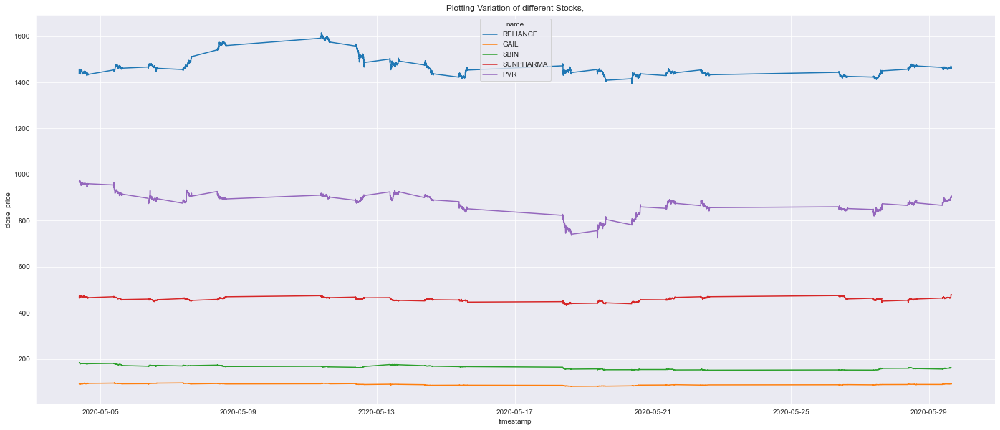

In [38]:
plt.figure(figsize=(24,10))
plt.title('Plotting Variation of different Stocks,')
sns.lineplot(curated_merged_df.timestamp, curated_merged_df.close_price, hue=curated_merged_df.name);

/Users/w1ufxk2/miniconda3/envs/stl/lib/python3.7/site-packages/seaborn/_decorators.py:43: FutureWarning: Pass the following variables as keyword args: x, y. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.
  FutureWarning


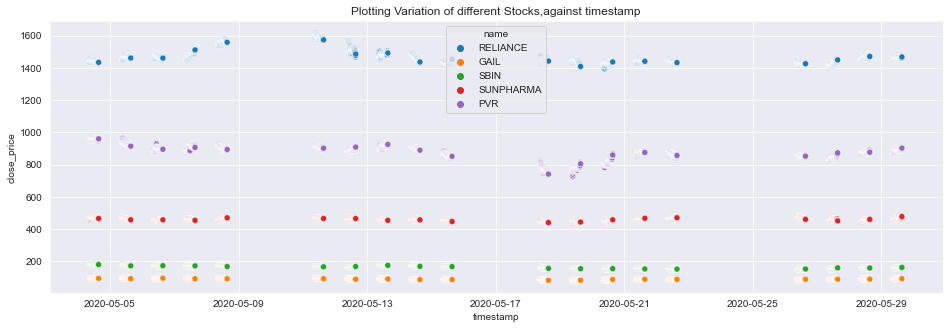

In [39]:
plt.figure(figsize=(16,5))
plt.title('Plotting Variation of different Stocks,against timestamp')
sns.scatterplot(curated_merged_df.timestamp, curated_merged_df.close_price, hue=curated_merged_df['name']);

Have Seperated out the month column from the timestamp, so we can have more precise results. **For Example:** If I wish I can observe a specific stock, lets say RELIANCE, and observe its values under a particular month or on a particular day of that month per say. 

In [40]:
#segregating month from the timestamp.
merged_df['month'] = pd.DatetimeIndex(merged_df.timestamp).month
timestamp_df['month'] = pd.DatetimeIndex(timestamp_df.index).month
merged_df

,timestamp,open_price,high_price,low_price,close_price,volume,scrip_id,name,month
0,2020-02-24 09:15:00+05:30,1170.00,1170.00,1149.25,1164.60,104528,2,INDUSINDBK,2
1,2020-02-24 09:16:00+05:30,1165.60,1168.50,1159.00,1160.75,109720,2,INDUSINDBK,2
2,2020-02-24 09:17:00+05:30,1162.35,1164.45,1161.00,1163.05,48984,2,INDUSINDBK,2
3,2020-02-24 09:18:00+05:30,1164.10,1168.85,1163.65,1168.85,67387,2,INDUSINDBK,2
4,2020-02-24 09:19:00+05:30,1168.35,1173.00,1166.45,1173.00,78541,2,INDUSINDBK,2
...,...,...,...,...,...,...,...,...,...
2321227,2020-09-03 15:25:00+05:30,1128.20,1129.00,1127.85,1127.85,61600,39,HDFCBANK20SEPFUT,9
2321228,2020-09-03 15:26:00+05:30,1127.70,1127.95,1126.50,1126.60,40700,39,HDFCBANK20SEPFUT,9
2321229,2020-09-03 15:27:00+05:30,1126.80,1126.85,1125.85,1126.70,26950,39,HDFCBANK20SEPFUT,9
2321230,2020-09-03 15:28:00+05:30,1126.80,1126.80,1125.50,1125.50,56650,39,HDFCBANK20SEPFUT,9


Now, to be able to visualize particular stocks, I can either call them up by **scrip_id/name** or **particular Month**, or **particular day.**

## Function to call a specific stock.

In [41]:
specific_coloumns=['timestamp','open_price','high_price','low_price','close_price','volume','month']

In [42]:
def call_this_stock(df, name):
    temp_df = merged_df[(merged_df.name ==name)]
    particular_stock = temp_df[specific_coloumns].copy()
    particular_stock.reset_index(drop=True, inplace=True)
    return particular_stock

def timestamp_as_index(df):
    temp = df
    temp = temp.set_index('timestamp', inplace=False)
    return temp

In [43]:
nifty_50 = call_this_stock(merged_df, 'NIFTY 50')
nifty_50_t = timestamp_as_index(nifty_50)
nifty_50

,timestamp,open_price,high_price,low_price,close_price,volume,month
0,2020-04-20 09:15:00+05:30,9390.20,9390.20,9306.25,9308.40,0,4
1,2020-04-20 09:16:00+05:30,9310.75,9319.35,9289.80,9291.40,0,4
2,2020-04-20 09:17:00+05:30,9292.00,9292.00,9270.70,9281.50,0,4
3,2020-04-20 09:18:00+05:30,9280.95,9296.55,9278.35,9290.30,0,4
4,2020-04-20 09:19:00+05:30,9288.25,9297.15,9280.75,9291.95,0,4
...,...,...,...,...,...,...,...
36368,2020-09-03 15:25:00+05:30,11530.95,11534.50,11530.00,11531.55,0,9
36369,2020-09-03 15:26:00+05:30,11531.80,11532.00,11530.50,11531.90,0,9
36370,2020-09-03 15:27:00+05:30,11532.40,11534.00,11531.55,11533.25,0,9
36371,2020-09-03 15:28:00+05:30,11533.40,11533.65,11531.20,11531.95,0,9


This above dataframe contains variation of a particular stock that we have chosen to be NIFTY 50, throughout the timevariation we have in the original data. 

Now, Lets observe this stock with some visual outputs.

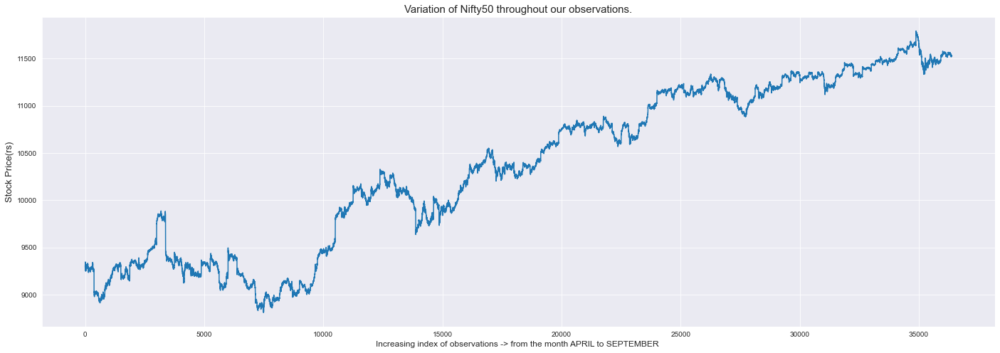

In [44]:
plt.figure(figsize=(24,8))
plt.title('Variation of Nifty50 throughout our observations.', fontsize= 15)
plt.ylabel('Stock Price(rs)', fontsize=13)
plt.xlabel('Increasing index of observations -> from the month APRIL to SEPTEMBER ', fontsize=12)
plt.plot(nifty_50.close_price);

In [18]:
nifty_50_t

,open_price,high_price,low_price,close_price,volume,month
timestamp,,,,,,
2020-04-20 09:15:00+05:30,9390.20,9390.20,9306.25,9308.40,0,4
2020-04-20 09:16:00+05:30,9310.75,9319.35,9289.80,9291.40,0,4
2020-04-20 09:17:00+05:30,9292.00,9292.00,9270.70,9281.50,0,4
2020-04-20 09:18:00+05:30,9280.95,9296.55,9278.35,9290.30,0,4
2020-04-20 09:19:00+05:30,9288.25,9297.15,9280.75,9291.95,0,4
...,...,...,...,...,...,...
2020-09-03 15:25:00+05:30,11530.95,11534.50,11530.00,11531.55,0,9
2020-09-03 15:26:00+05:30,11531.80,11532.00,11530.50,11531.90,0,9
2020-09-03 15:27:00+05:30,11532.40,11534.00,11531.55,11533.25,0,9


/Users/w1ufxk2/miniconda3/envs/stl/lib/python3.7/site-packages/seaborn/_decorators.py:43: FutureWarning: Pass the following variable as a keyword arg: x. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.
  FutureWarning


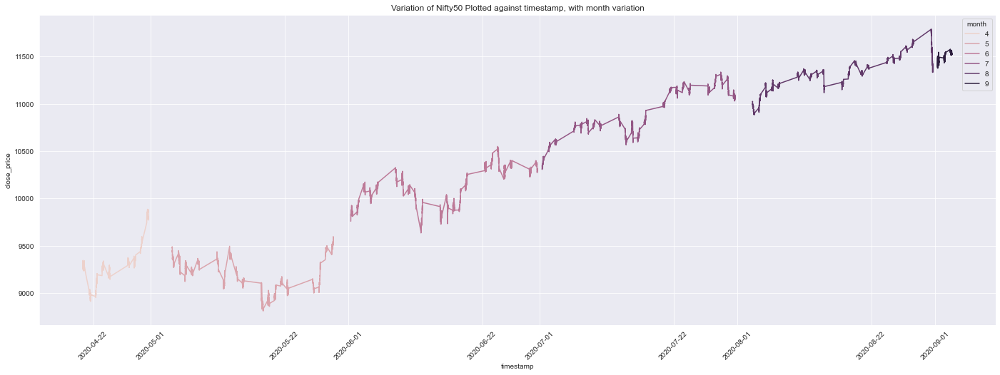

In [45]:
plt.figure(figsize=(24,8))
plt.title('Variation of Nifty50 Plotted against timestamp, with month variation')
plt.xticks(rotation = 45)
sns.lineplot(nifty_50_t.index, y= nifty_50_t.close_price, hue=nifty_50_t.month);

With the timestamp as index, the graph has few continous points in between. This is because, we only have data of the days the stock market is open. Example: we dont have data for weekends, or any other holidays, or even the time the market is close. Whereas, When I plotted stock prices against index, there were a continuity in the values. 

In [46]:
reliance = call_this_stock(merged_df, 'RELIANCE')
reliance

,timestamp,open_price,high_price,low_price,close_price,volume,month
0,2020-02-24 09:15:00+05:30,1469.75,1469.75,1463.10,1465.05,150673,2
1,2020-02-24 09:16:00+05:30,1464.80,1466.90,1463.85,1465.75,70326,2
2,2020-02-24 09:17:00+05:30,1465.55,1466.15,1464.00,1464.20,48558,2
3,2020-02-24 09:18:00+05:30,1464.20,1465.85,1464.05,1464.45,30801,2
4,2020-02-24 09:19:00+05:30,1464.95,1465.80,1463.80,1465.60,32519,2
...,...,...,...,...,...,...,...
49376,2020-09-03 15:25:00+05:30,2111.80,2112.15,2111.70,2112.10,29615,9
49377,2020-09-03 15:26:00+05:30,2112.15,2113.50,2112.10,2113.50,27741,9
49378,2020-09-03 15:27:00+05:30,2113.25,2113.90,2113.25,2113.50,23380,9
49379,2020-09-03 15:28:00+05:30,2113.85,2114.20,2113.00,2113.50,31974,9


/Users/w1ufxk2/miniconda3/envs/stl/lib/python3.7/site-packages/seaborn/_decorators.py:43: FutureWarning: Pass the following variable as a keyword arg: x. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.
  FutureWarning


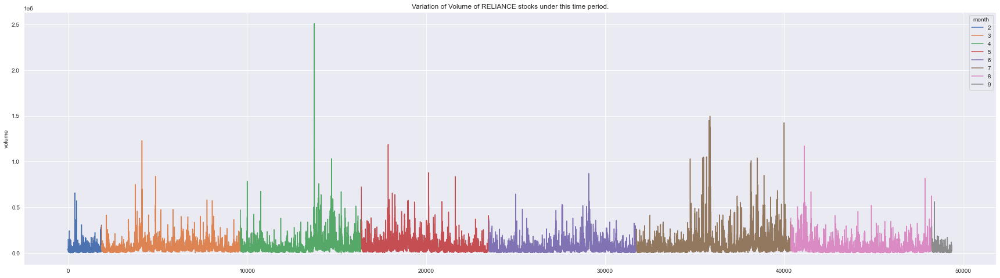

In [47]:
plt.figure(figsize=(30,8))
plt.title('Variation of Volume of RELIANCE stocks under this time period.')
sns.lineplot(reliance.index, y= reliance.volume, hue=reliance.month, palette="deep");

### Function to get a slope coloumn

In [48]:
def cal_slope(unit_value, df, column):
    df['slope_%s'%(column)] = ((df[column] - df[column].shift(unit_value))/unit_value).round(10)


In [49]:
#Choosing a specific month frm the entire dataset.
def choose_month(df, month):
    df = df[(df.month == month)]
    return df

In [50]:
nifty_50_april = choose_month(nifty_50, 4)
nifty_50_t_april = choose_month(nifty_50, 4)
reliance_april = choose_month(reliance, 4)

In [51]:
nifty_50_april 

,timestamp,open_price,high_price,low_price,close_price,volume,month
0,2020-04-20 09:15:00+05:30,9390.20,9390.20,9306.25,9308.40,0,4
1,2020-04-20 09:16:00+05:30,9310.75,9319.35,9289.80,9291.40,0,4
2,2020-04-20 09:17:00+05:30,9292.00,9292.00,9270.70,9281.50,0,4
3,2020-04-20 09:18:00+05:30,9280.95,9296.55,9278.35,9290.30,0,4
4,2020-04-20 09:19:00+05:30,9288.25,9297.15,9280.75,9291.95,0,4
...,...,...,...,...,...,...,...
3370,2020-04-30 15:25:00+05:30,9866.00,9866.20,9860.05,9861.75,0,4
3371,2020-04-30 15:26:00+05:30,9861.65,9862.85,9857.10,9858.70,0,4
3372,2020-04-30 15:27:00+05:30,9858.50,9858.60,9856.20,9857.60,0,4
3373,2020-04-30 15:28:00+05:30,9857.25,9857.95,9853.80,9856.20,0,4


### Autocorelation, corelation Plot. 

Autocorrelation plot, tells us the similarity between observations as a function of time lag between them. It is designed to show whether the elements of a time series are positively correlated, negatively correlated, or independent of each other. It can range from –1 to 1.

The horizontal axis of an autocorrelation plot shows the size of the lag between the elements of the time series. For example, the autocorrelation with lag 2 is the correlation between the time series elements and the corresponding elements that were observed two time periods earlier.

The kth lag is the time period that happened “k” time points before time i.


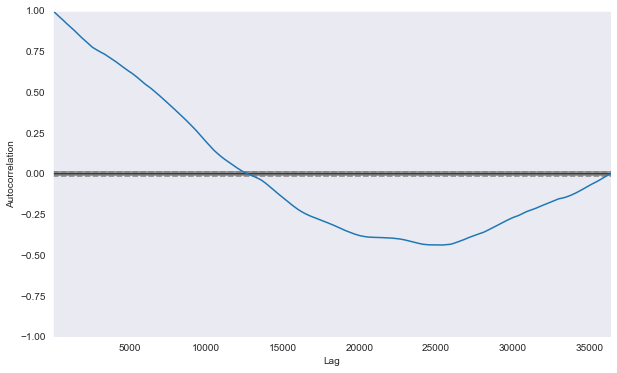

In [52]:
#from pandas.plotting import autocorrelation_plot
plt.rc("figure", figsize=(10,6))
pd.plotting.autocorrelation_plot(nifty_50['close_price']);

Well, we have a -ve autocorrelation here, meaning that the close_price values after the time lag are not dependant on the close_price values before the time lag.

In [53]:
import statsmodels.api as sm

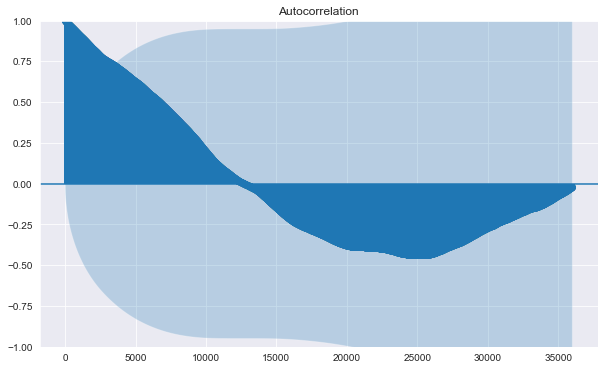

In [54]:
plt.rc("figure", figsize=(10,6))
sm.graphics.tsa.plot_acf(nifty_50['close_price'], lags = 36000);

##  Before Removing Trend

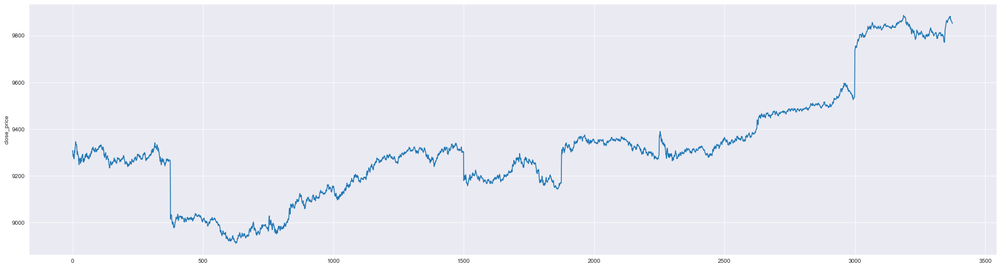

In [55]:
plt.figure(figsize=(30,8))
sns.lineplot(data=nifty_50_april['close_price'], palette="deep");

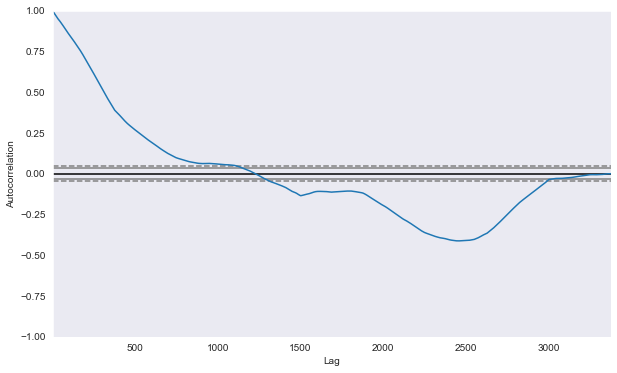

In [56]:
plt.rc("figure", figsize=(10,6))
pd.plotting.autocorrelation_plot(nifty_50_april['close_price']);

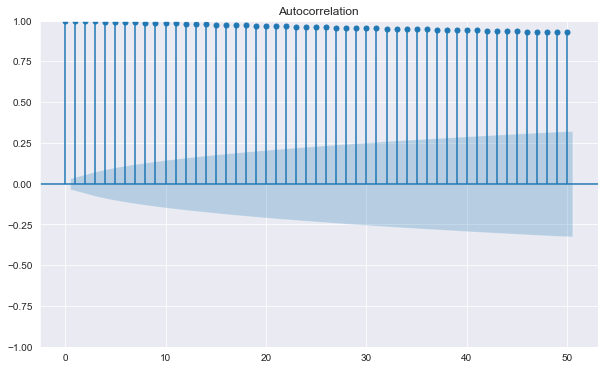

In [57]:
plt.rc("figure", figsize=(10,6))
sm.graphics.tsa.plot_acf(nifty_50_april['close_price'], lags=50);

Differencing. 
Differencing is a popular and widely used data transform for making time series data stationary.

difference(t) = observation(t) - observation(t-1)

## After removing Trend

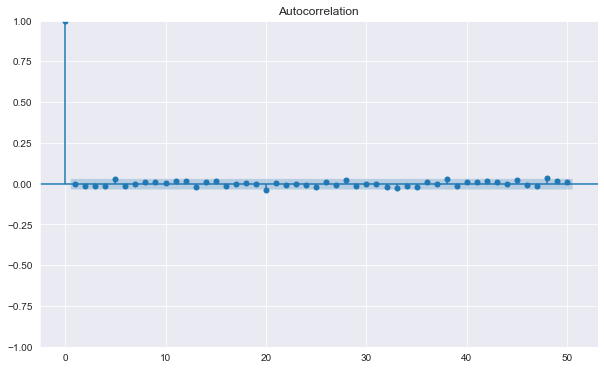

In [58]:
data = nifty_50_april['close_price'] - nifty_50_april['close_price'].shift(1)
plt.rc("figure", figsize=(10,6))
sm.graphics.tsa.plot_acf(data[1:], lags=50);

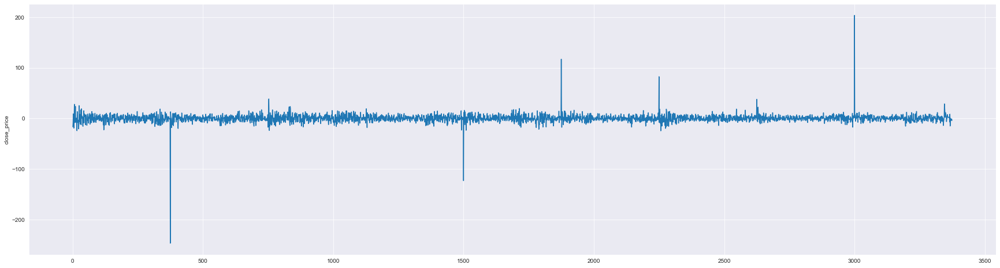

In [59]:
plt.figure(figsize=(30,8))
sns.lineplot(data=data[1:], palette="deep");

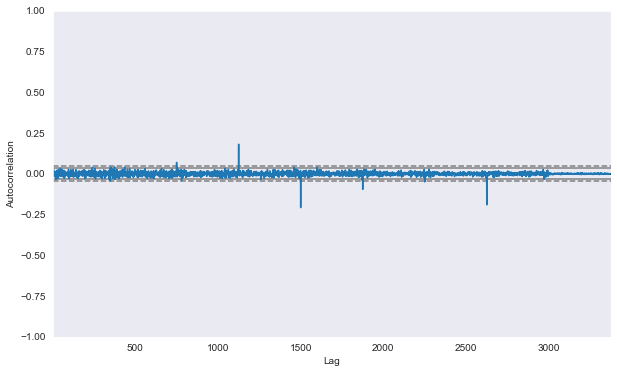

In [60]:
pd.plotting.autocorrelation_plot(data[1:]);

In [61]:
data

0         NaN
1      -17.00
2       -9.90
3        8.80
4        1.65
        ...  
3370    -4.45
3371    -3.05
3372    -1.10
3373    -1.40
3374    -4.35
Name: close_price, Length: 3375, dtype: float64

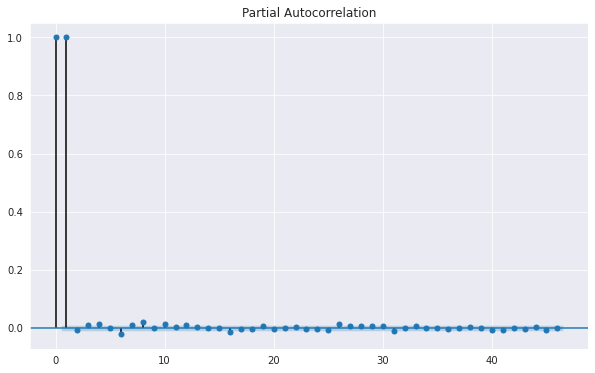

In [47]:
plt.rc("figure", figsize=(10,6))
sm.graphics.tsa.plot_pacf(nifty_50['close_price']);

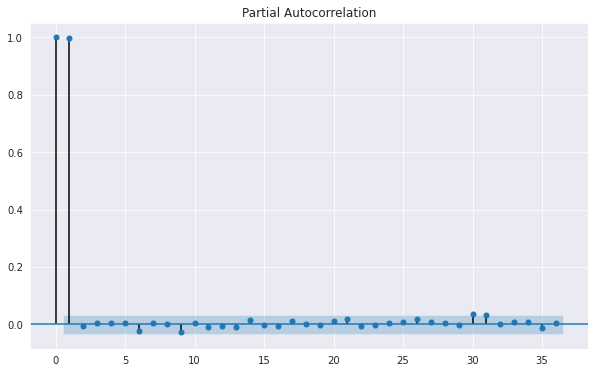

In [48]:
plt.rc("figure", figsize=(10,6))
sm.graphics.tsa.plot_pacf(nifty_50_april['close_price']);

## Partial AutoCorrelation After Removing Trend

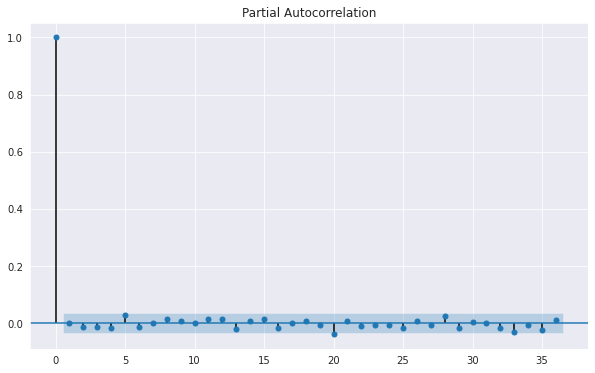

In [73]:
plt.rc("figure", figsize=(10,6))
sm.graphics.tsa.plot_pacf(data[1:]);

In [52]:
cal_slope(10, nifty_50, 'close_price')

In [62]:
nifty_50

,timestamp,open_price,high_price,low_price,close_price,volume,month
0,2020-04-20 09:15:00+05:30,9390.20,9390.20,9306.25,9308.40,0,4
1,2020-04-20 09:16:00+05:30,9310.75,9319.35,9289.80,9291.40,0,4
2,2020-04-20 09:17:00+05:30,9292.00,9292.00,9270.70,9281.50,0,4
3,2020-04-20 09:18:00+05:30,9280.95,9296.55,9278.35,9290.30,0,4
4,2020-04-20 09:19:00+05:30,9288.25,9297.15,9280.75,9291.95,0,4
...,...,...,...,...,...,...,...
36368,2020-09-03 15:25:00+05:30,11530.95,11534.50,11530.00,11531.55,0,9
36369,2020-09-03 15:26:00+05:30,11531.80,11532.00,11530.50,11531.90,0,9
36370,2020-09-03 15:27:00+05:30,11532.40,11534.00,11531.55,11533.25,0,9
36371,2020-09-03 15:28:00+05:30,11533.40,11533.65,11531.20,11531.95,0,9


In [63]:
def corr_matrix(df):
    #correlation_matrix = df.drop(['volume'], axis=1)
    correlation_matrix = df.drop(['volume'], axis=1).corr()
    print(correlation_matrix)
    
    fig, ax = plt.subplots(figsize=(13,10))

    sns.heatmap(correlation_matrix,
                annot=True,
                fmt='.2f',
                #cmap='YlGnBu',
                ax=ax);
    plt.xticks(fontsize=14)
    plt.yticks(fontsize=14);

                   open_price  high_price  low_price  close_price     month  \
open_price           1.000000    0.999991   0.999989     0.999979  0.936798   
high_price           0.999991    1.000000   0.999988     0.999991  0.936807   
low_price            0.999989    0.999988   1.000000     0.999992  0.936785   
close_price          0.999979    0.999991   0.999992     1.000000  0.936796   
month                0.936798    0.936807   0.936785     0.936796  1.000000   
slope_close_price    0.013885    0.014638   0.014794     0.015239  0.001234   

                   slope_close_price  
open_price                  0.013885  
high_price                  0.014638  
low_price                   0.014794  
close_price                 0.015239  
month                       0.001234  
slope_close_price           1.000000  


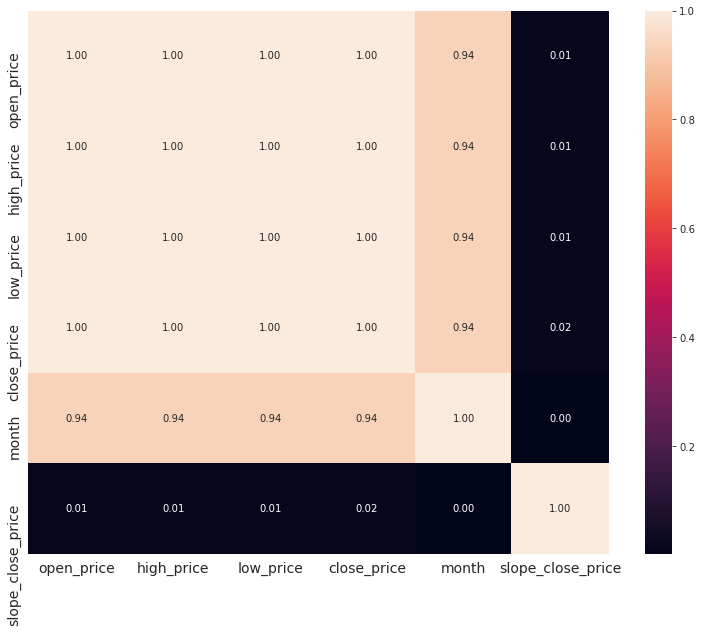

In [54]:
corr_matrix(nifty_50)

             open_price  high_price  low_price  close_price  month
open_price     1.000000    0.999849   0.999829     0.999619    NaN
high_price     0.999849    1.000000   0.999822     0.999846    NaN
low_price      0.999829    0.999822   1.000000     0.999859    NaN
close_price    0.999619    0.999846   0.999859     1.000000    NaN
month               NaN         NaN        NaN          NaN    NaN


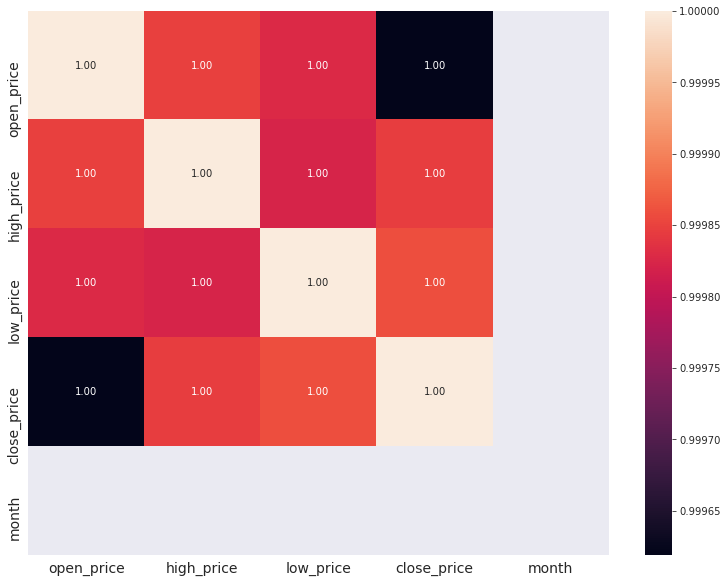

In [55]:
corr_matrix(nifty_50_april)

### Checking If Our Data is Stationary or not.

A quick and dirty check to see if your time series is non-stationary is to review summary statistics.

You can split your time series into two (or more) partitions and compare the mean and variance of each group. If they differ and the difference is statistically significant, the time series is likely non-stationary.

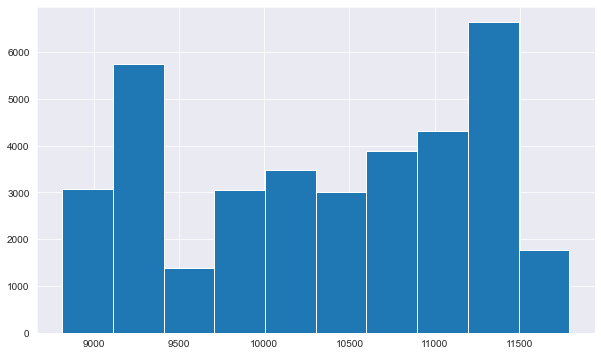

In [64]:
nifty_50['close_price'].hist()
plt.show();

In [65]:
X = nifty_50['close_price'].values
split = round(len(X) / 2)
X1, X2 = X[0:split], X[split:]
mean1, mean2 = X1.mean(), X2.mean()
var1, var2 = X1.var(), X2.var()
print('mean1=%f, mean2=%f' % (mean1, mean2))
print('variance1=%f, variance2=%f' % (var1, var2))

mean1=9603.421572, mean2=11105.933332
variance1=223878.109347, variance2=114346.102623


For the month data..

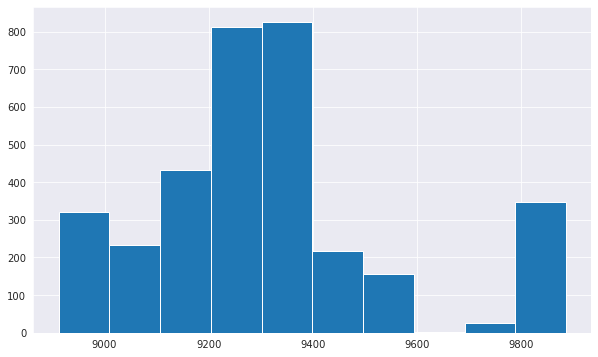

In [58]:
nifty_50_april['close_price'].hist()
plt.show();

In [59]:
X = nifty_50_april['close_price'].values
split = round(len(X) / 2)
X1, X2 = X[0:split], X[split:]
mean1, mean2 = X1.mean(), X2.mean()
var1, var2 = X1.var(), X2.var()
print('mean1=%f, mean2=%f' % (mean1, mean2))
print('variance1=%f, variance2=%f' % (var1, var2))

mean1=9166.116973, mean2=9464.824778
variance1=16449.605830, variance2=44951.527240


The Augmented Dickey-Fuller test is a type of statistical test called a unit root test. The intuition behind a unit root test is that it determines how strongly a time series is defined by a trend.
There are a number of unit root tests and the Augmented Dickey-Fuller may be one of the more widely used. It uses an autoregressive model and optimizes an information criterion across multiple different lag values.

The statsmodels library provides the adfuller() function that implements the test.
[Link to Stationarity.](https://machinelearningmastery.com/time-series-data-stationary-python/)

In [66]:
from statsmodels.tsa.stattools import adfuller

In [67]:
X = nifty_50['close_price'].values

result = adfuller(X)
print('ADF Statistic: %f' % result[0])
print('p-value: %f' % result[1])
print('Critical Values:')
for key, value in result[4].items():
	print('\t%s: %.3f' % (key, value))

ADF Statistic: -0.663206
p-value: 0.856051
Critical Values:
	1%: -3.431
	5%: -2.862
	10%: -2.567


p-value > 0.05: Fail to reject the null hypothesis (H0), the data has a unit root and is non-stationary.
p-value <= 0.05: Reject the null hypothesis (H0), the data does not have a unit root and is stationary.


Running the example prints the test statistic value of -4. The more negative this statistic, the more likely we are to reject the null hypothesis (we have a stationary dataset).

As part of the output, we get a look-up table to help determine the ADF statistic. We can see that our statistic value of -4 is less than the value of -3.449 at 1%.

This suggests that we can reject the null hypothesis with a significance level of less than 1% (i.e. a low probability that the result is a statistical fluke).

Rejecting the null hypothesis means that the process has no unit root, and in turn that the time series is stationary or does not have time-dependent structure.

## Removing Trend from our non-stationary data.

In [68]:
X = data[1:].values

result = adfuller(X)
print('ADF Statistic: %f' % result[0])
print('p-value: %f' % result[1])
print('Critical Values:')
for key, value in result[4].items():
	print('\t%s: %.3f' % (key, value))

ADF Statistic: -58.045640
p-value: 0.000000
Critical Values:
	1%: -3.432
	5%: -2.862
	10%: -2.567


In [69]:
X = data[1:].values
split = round(len(X) / 2)
X1, X2 = X[0:split], X[split:]
mean1, mean2 = X1.mean(), X2.mean()
var1, var2 = X1.var(), X2.var()
print('mean1=%f, mean2=%f' % (mean1, mean2))
print('variance1=%f, variance2=%f' % (var1, var2))

mean1=-0.035388, mean2=0.357528
variance1=87.897485, variance2=67.514623


### Introducing Rolling mean/Moving Avg:

Since Time Series data is highly fluctuating, or lets say Noisy, this is a transformation method which
helps to average out noise from the data. It works by simply splitting and aggregating the data into
windows according to function.
I have calculated two moving averages with windows 30 and 100 as Small MA and Large MA.

In [72]:
def small_ma(df, column='close_price'):
    df['small_ma'] = df[column].rolling(window=30).mean()
    return df

def large_ma(df, column='close_price'):
    df['large_ma'] = df[column].rolling(window=100).mean()
    return df 

/Users/w1ufxk2/miniconda3/envs/stl/lib/python3.7/site-packages/seaborn/_decorators.py:43: FutureWarning: Pass the following variable as a keyword arg: x. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.
  FutureWarning


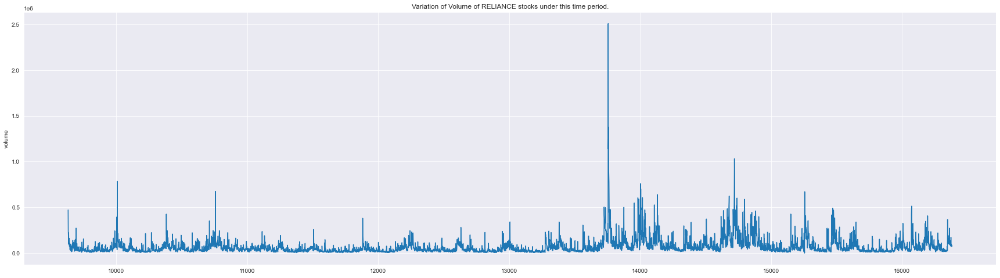

In [73]:
plt.figure(figsize=(30,8))
plt.title('Variation of Volume of RELIANCE stocks under this time period.')
sns.lineplot(reliance_april.index, y= reliance_april.volume, dashes = True);

In [74]:
nifty_50_april = small_ma(nifty_50_april)
nifty_50_april = large_ma(nifty_50_april)
nifty_50_april 

/Users/w1ufxk2/miniconda3/envs/stl/lib/python3.7/site-packages/ipykernel_launcher.py:2: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  
/Users/w1ufxk2/miniconda3/envs/stl/lib/python3.7/site-packages/ipykernel_launcher.py:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  


,timestamp,open_price,high_price,low_price,close_price,volume,month,small_ma,large_ma
0,2020-04-20 09:15:00+05:30,9390.20,9390.20,9306.25,9308.40,0,4,NaN,NaN
1,2020-04-20 09:16:00+05:30,9310.75,9319.35,9289.80,9291.40,0,4,NaN,NaN
2,2020-04-20 09:17:00+05:30,9292.00,9292.00,9270.70,9281.50,0,4,NaN,NaN
3,2020-04-20 09:18:00+05:30,9280.95,9296.55,9278.35,9290.30,0,4,NaN,NaN
4,2020-04-20 09:19:00+05:30,9288.25,9297.15,9280.75,9291.95,0,4,NaN,NaN
...,...,...,...,...,...,...,...,...,...
3370,2020-04-30 15:25:00+05:30,9866.00,9866.20,9860.05,9861.75,0,4,9848.818333,9818.9995
3371,2020-04-30 15:26:00+05:30,9861.65,9862.85,9857.10,9858.70,0,4,9851.460000,9819.6665
3372,2020-04-30 15:27:00+05:30,9858.50,9858.60,9856.20,9857.60,0,4,9854.275000,9820.2390
3373,2020-04-30 15:28:00+05:30,9857.25,9857.95,9853.80,9856.20,0,4,9857.118333,9820.8130


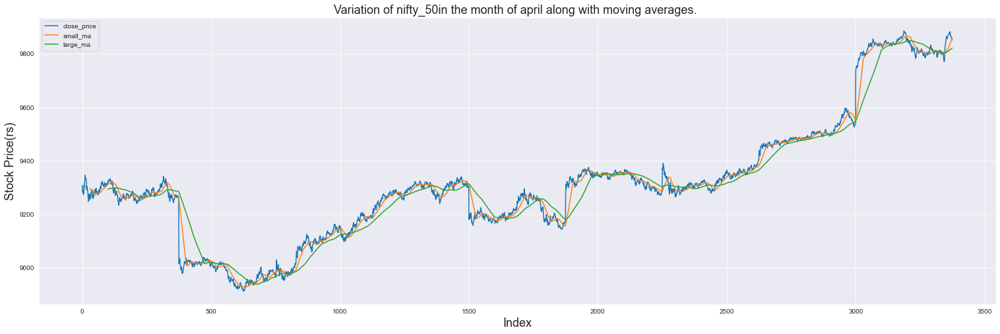

In [75]:
plt.figure(figsize=(26,8))
plt.title('Variation of nifty_50in the month of april along with moving averages. ', fontsize=18)
plt.plot(nifty_50_april.close_price)
plt.plot(nifty_50_april.small_ma)
plt.plot(nifty_50_april.large_ma)
plt.ylabel('Stock Price(rs)', fontsize=18)
plt.xlabel('Index', fontsize=18)
plt.legend(['close_price','small_ma','large_ma'], loc='upper left');

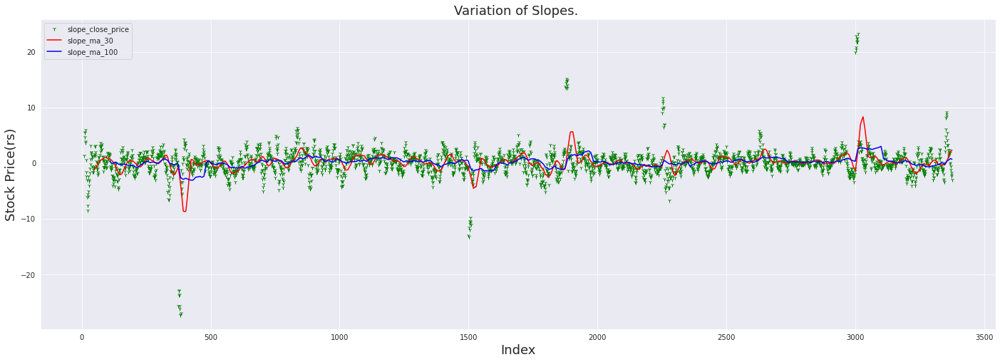

In [89]:
plt.figure(figsize=(24,8))
plt.title('Variation of Slopes. ', fontsize=18)
plt.plot(nifty_50_april.slope_close_price, 'g1')
plt.plot(nifty_50_april.slope_small_ma,'r-')
plt.plot(nifty_50_april.slope_large_ma, 'b-')
plt.ylabel('Stock Price(rs)', fontsize=18)
plt.xlabel('Index', fontsize=18)
plt.legend(['slope_close_price','slope_ma_30','slope_ma_100'], loc='upper left');

In [90]:
#Removing unnecessary columns!
nifty_50_april.drop(['slope_small_ma','slope_large_ma','slope_close_price'], axis=1, inplace=True)
nifty_50_april.head()

/opt/conda/lib/python3.7/site-packages/pandas/core/frame.py:4174: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  errors=errors,


,timestamp,open_price,high_price,low_price,close_price,volume,month,small_ma,large_ma
0,2020-04-20 09:15:00+05:30,9390.20,9390.20,9306.25,9308.40,0,4,NaN,NaN
1,2020-04-20 09:16:00+05:30,9310.75,9319.35,9289.80,9291.40,0,4,NaN,NaN
2,2020-04-20 09:17:00+05:30,9292.00,9292.00,9270.70,9281.50,0,4,NaN,NaN
3,2020-04-20 09:18:00+05:30,9280.95,9296.55,9278.35,9290.30,0,4,NaN,NaN
4,2020-04-20 09:19:00+05:30,9288.25,9297.15,9280.75,9291.95,0,4,NaN,NaN


In [19]:
from sklearn.metrics import mean_absolute_error

In [92]:
def plot_moving_average(df, window, column, plot_intervals=False, scale=1.96, plot_slopes=False):

    #rolling_mean = series.rolling(window=window).mean()
    series = df.close_price
    rolling_mean = df[column]
    
    plt.figure(figsize=(17,8))
    plt.title('Moving average\n window size = {}'.format(window))
    plt.plot(rolling_mean, 'g', label='Rolling mean trend')
    
    #Plot confidence intervals for smoothed values
    if plot_intervals:
        mae = mean_absolute_error(series[window:], rolling_mean[window:])
        deviation = np.std(series[window:] - rolling_mean[window:])
        lower_bound = rolling_mean - (mae + scale * deviation)
        upper_bound = rolling_mean + (mae + scale * deviation)
        plt.plot(upper_bound, 'r--', label='Upper bound / Lower bound')
        plt.plot(lower_bound, 'r--')
        
    if plot_slopes:
        plt.plot(df['slope_%s' % column], 'm,', label='Slope_MA')
            
    plt.plot(series[window:], label='Actual clsing_price values')
    plt.legend(loc='best')
    plt.grid(True)

Results of smoothed out values of our closing prices.

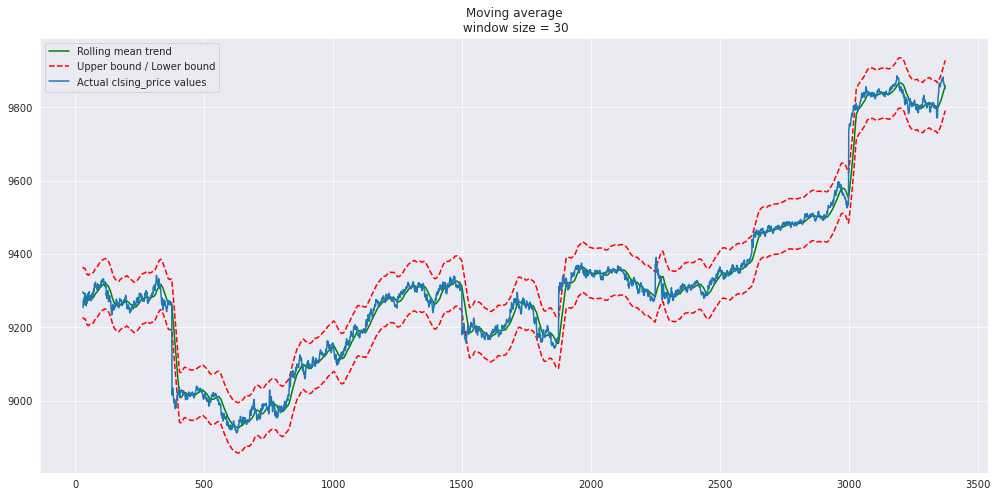

In [93]:
plot_moving_average(nifty_50_april, 30, column='small_ma', plot_intervals=True)

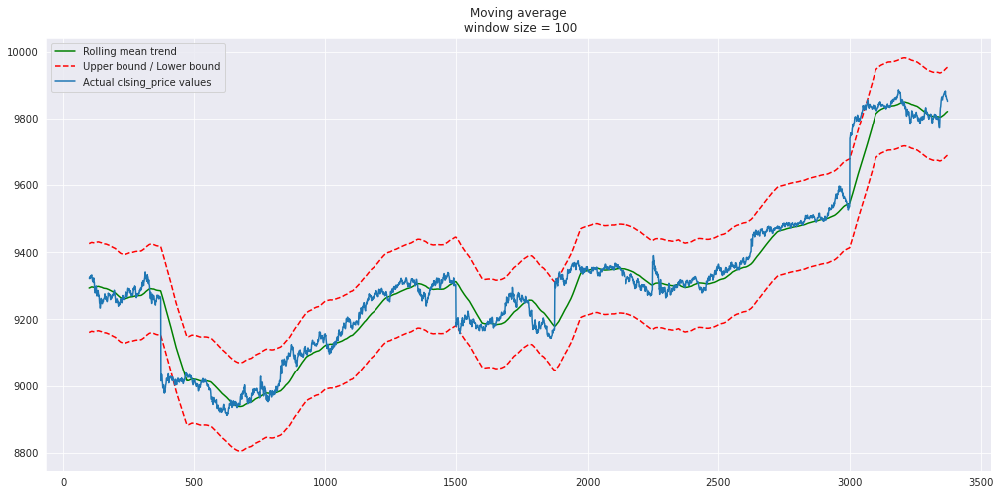

In [94]:
plot_moving_average(nifty_50_april, 100, column='large_ma', plot_intervals=True)

## Exponential Smoothing

In [95]:
nifty_50_april.drop(['small_ma','large_ma'], axis=1, inplace=True)
nifty_50_april

/opt/conda/lib/python3.7/site-packages/pandas/core/frame.py:4174: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  errors=errors,


,timestamp,open_price,high_price,low_price,close_price,volume,month
0,2020-04-20 09:15:00+05:30,9390.20,9390.20,9306.25,9308.40,0,4
1,2020-04-20 09:16:00+05:30,9310.75,9319.35,9289.80,9291.40,0,4
2,2020-04-20 09:17:00+05:30,9292.00,9292.00,9270.70,9281.50,0,4
3,2020-04-20 09:18:00+05:30,9280.95,9296.55,9278.35,9290.30,0,4
4,2020-04-20 09:19:00+05:30,9288.25,9297.15,9280.75,9291.95,0,4
...,...,...,...,...,...,...,...
3370,2020-04-30 15:25:00+05:30,9866.00,9866.20,9860.05,9861.75,0,4
3371,2020-04-30 15:26:00+05:30,9861.65,9862.85,9857.10,9858.70,0,4
3372,2020-04-30 15:27:00+05:30,9858.50,9858.60,9856.20,9857.60,0,4
3373,2020-04-30 15:28:00+05:30,9857.25,9857.95,9853.80,9856.20,0,4


2 methods of doing this. 

In [20]:
nifty_50_april

,timestamp,open_price,high_price,low_price,close_price,volume,month
0,2020-04-20 09:15:00+05:30,9390.20,9390.20,9306.25,9308.40,0,4
1,2020-04-20 09:16:00+05:30,9310.75,9319.35,9289.80,9291.40,0,4
2,2020-04-20 09:17:00+05:30,9292.00,9292.00,9270.70,9281.50,0,4
3,2020-04-20 09:18:00+05:30,9280.95,9296.55,9278.35,9290.30,0,4
4,2020-04-20 09:19:00+05:30,9288.25,9297.15,9280.75,9291.95,0,4
...,...,...,...,...,...,...,...
3370,2020-04-30 15:25:00+05:30,9866.00,9866.20,9860.05,9861.75,0,4
3371,2020-04-30 15:26:00+05:30,9861.65,9862.85,9857.10,9858.70,0,4
3372,2020-04-30 15:27:00+05:30,9858.50,9858.60,9856.20,9857.60,0,4
3373,2020-04-30 15:28:00+05:30,9857.25,9857.95,9853.80,9856.20,0,4


In [21]:
data = nifty_50_april['close_price'].copy()
data

0       9308.40
1       9291.40
2       9281.50
3       9290.30
4       9291.95
         ...   
3370    9861.75
3371    9858.70
3372    9857.60
3373    9856.20
3374    9851.85
Name: close_price, Length: 3375, dtype: float64

In [22]:
from statsmodels.tsa.api import SimpleExpSmoothing

In [23]:
#First Instance
ins1 = SimpleExpSmoothing(data).fit(smoothing_level=0.2,optimized=False)
ins_cast1 = ins1.forecast(3).rename('alpha=0.')

In [24]:
#Second Instance
ins2 = SimpleExpSmoothing(data).fit(smoothing_level=0.8,optimized=False)
ins_cast2 = ins2.forecast(3).rename('alpha=0.08')

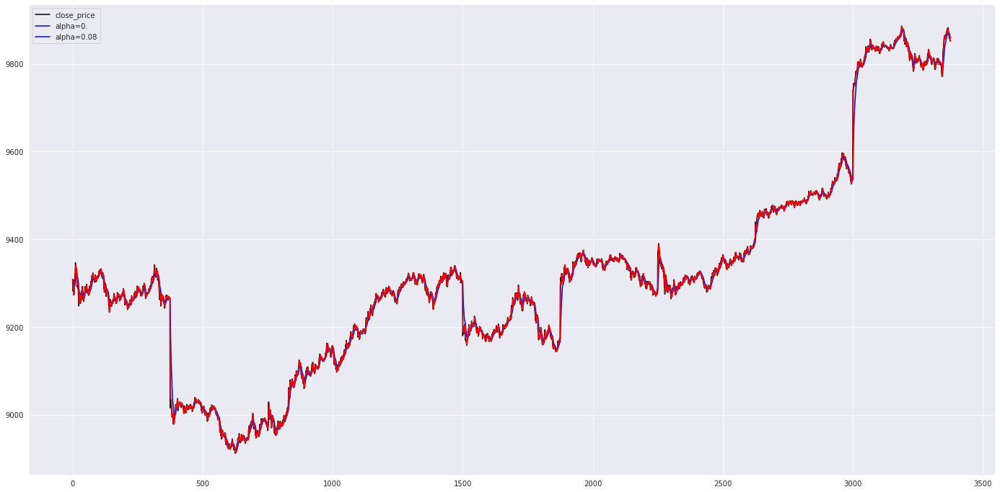

In [25]:
#After creating model we will visualize the plot
ax = data.plot( color='black', figsize=(24,12), legend=True)

#Plot for alpha =0.2
ins_cast1.plot( ax=ax, color='blue', legend=True)
ins1.fittedvalues.plot( ax=ax, color='blue')

#Plot for alpha = 0.8
ins_cast2.plot( ax=ax, color='red', legend=True)
ins2.fittedvalues.plot( ax=ax, color='red')

Plotted exponential smoothing for a day but the graph is not really helpful.

In [26]:
# SINGLE DAY OBSERVATIONS.
import pytz
import datetime
#pytz -- > for cross platform timecalculation
timezone_str = 'Asia/Kolkata'
localtz = pytz.timezone(timezone_str)

def create_timestamp_obj(time_str):
    return localtz.localize(datetime.datetime.strptime(time_str, '%Y-%m-%d-%H-%M-%S'))

In [30]:
nifty_50_april.set_index('timestamp', inplace = True)

In [31]:
start_time = create_timestamp_obj('2020-04-20-09-15-00')
end_time = create_timestamp_obj('2020-04-20-15-29-00')

In [32]:
stock_one_day = nifty_50_april[start_time:end_time]
stock_one_day

,open_price,high_price,low_price,close_price,volume,month
timestamp,,,,,,
2020-04-20 09:15:00+05:30,9390.20,9390.20,9306.25,9308.40,0,4
2020-04-20 09:16:00+05:30,9310.75,9319.35,9289.80,9291.40,0,4
2020-04-20 09:17:00+05:30,9292.00,9292.00,9270.70,9281.50,0,4
2020-04-20 09:18:00+05:30,9280.95,9296.55,9278.35,9290.30,0,4
2020-04-20 09:19:00+05:30,9288.25,9297.15,9280.75,9291.95,0,4
...,...,...,...,...,...,...
2020-04-20 15:25:00+05:30,9266.65,9269.40,9265.45,9269.05,0,4
2020-04-20 15:26:00+05:30,9269.45,9269.75,9267.70,9267.70,0,4
2020-04-20 15:27:00+05:30,9267.20,9268.60,9266.50,9266.60,0,4


Finding the exponential smoothing for monthly data did not give much conclusions, so we Picked up day's data for exponential smoothing.

In [33]:
day_data = stock_one_day['close_price'].copy()
day_data

timestamp
2020-04-20 09:15:00+05:30    9308.40
2020-04-20 09:16:00+05:30    9291.40
2020-04-20 09:17:00+05:30    9281.50
2020-04-20 09:18:00+05:30    9290.30
2020-04-20 09:19:00+05:30    9291.95
                              ...   
2020-04-20 15:25:00+05:30    9269.05
2020-04-20 15:26:00+05:30    9267.70
2020-04-20 15:27:00+05:30    9266.60
2020-04-20 15:28:00+05:30    9266.40
2020-04-20 15:29:00+05:30    9262.00
Name: close_price, Length: 375, dtype: float64

In [34]:
#First Instance
ins11 = SimpleExpSmoothing(day_data).fit(smoothing_level=0.2,optimized=False)
ins_cast11 = ins11.forecast(3).rename('alpha=0.')

/opt/conda/lib/python3.7/site-packages/statsmodels/tsa/base/tsa_model.py:162: ValueWarning: No frequency information was provided, so inferred frequency T will be used.
  % freq, ValueWarning)


In [35]:
#Second Instance
ins22 = SimpleExpSmoothing(day_data).fit(smoothing_level=0.8,optimized=False)
ins_cast22 = ins22.forecast(3).rename('alpha=0.8')

/opt/conda/lib/python3.7/site-packages/statsmodels/tsa/base/tsa_model.py:162: ValueWarning: No frequency information was provided, so inferred frequency T will be used.
  % freq, ValueWarning)


In [36]:
#Third Instance
ins33 = SimpleExpSmoothing(day_data).fit()
ins_cast33 = ins33.forecast(3).rename('alpha=%s'%ins33.model.params['smoothing_level'])

/opt/conda/lib/python3.7/site-packages/statsmodels/tsa/base/tsa_model.py:162: ValueWarning: No frequency information was provided, so inferred frequency T will be used.
  % freq, ValueWarning)


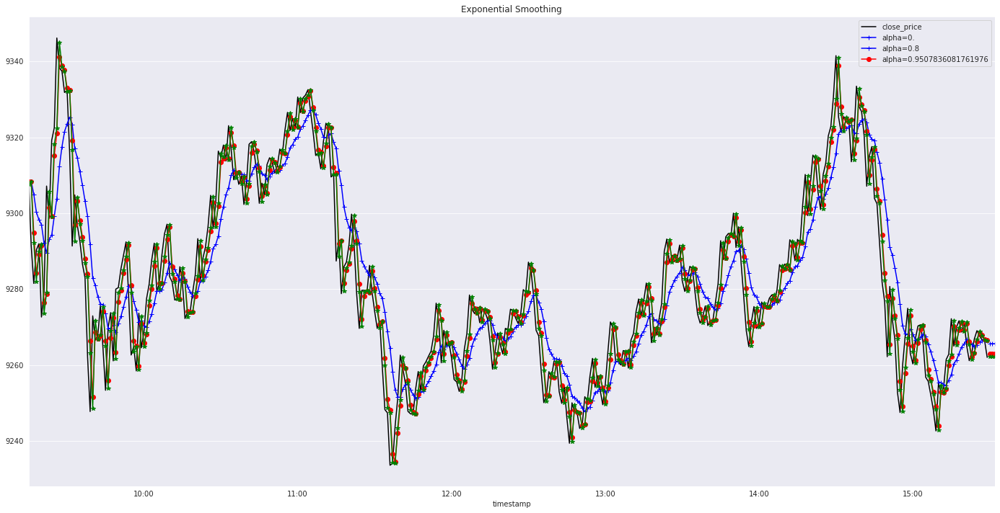

In [44]:
ax1 = day_data.plot( color='black', figsize=(24,12), legend=True)

#Plot for alpha =0.2
ins_cast11.plot(marker='+', ax=ax1, color='blue', legend=True)
ins11.fittedvalues.plot(marker='+', ax=ax1, color='blue')

ins_cast22.plot(marker='o', ax=ax1, color='red', legend=True)
ins22.fittedvalues.plot(marker='o', ax=ax1, color='red')

#Plot for alpha=Optimized by statsmodel
ins_cast33.plot(marker='*', ax=ax1, color='green', legend=True)
ins33.fittedvalues.plot(marker='*', ax=ax1, color='green')

plt.title("Exponential Smoothing")
plt.show()

[Link for exponential Smoothing](https://analyticsindiamag.com/hands-on-guide-to-time-series-analysis-using-simple-exponential-smoothing-in-python/)

The next method is using the mathematical formula directly instead of using the statsmodel library. 

F(t+1) = F(t) + α(A(t) - F(t))

* A(t) - F(t) ---> Fraction of error from last period.
* α ---> Smoothing Constant, and should be 0≤α≤1

In [40]:
def exponential_smoothing(series, alpha):
    result = [series[0]] # first value is same as series
    for n in range(1, len(series)):
        result.append(alpha * series[n] + (1 - alpha) * result[n-1])
    return result


In [41]:
def plot_exponential_smoothing(series, alphas):
    plt.figure(figsize=(17, 8))
    for alpha in alphas:
        plt.plot(exponential_smoothing(series, alpha), label="Alpha {}".format(alpha))
    plt.plot(series.values, "c", label = "Actual")
    plt.legend(loc="best")
    plt.axis('tight')
    plt.title("Exponential Smoothing")
    plt.grid(True);

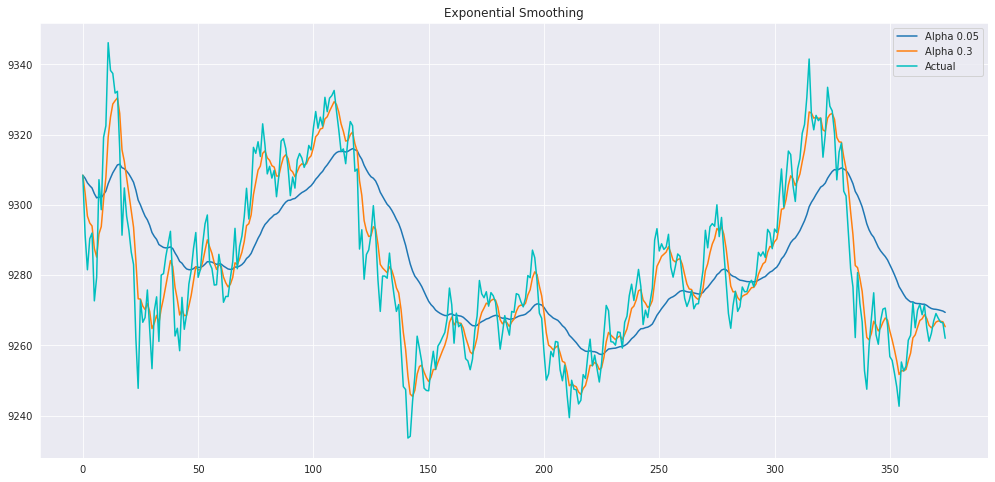

In [43]:
plot_exponential_smoothing(stock_one_day['close_price'], [0.05, 0.3])

In [45]:
nifty_50_april = choose_month(nifty_50, 4)

In [49]:
nifty_50_april = small_ma(nifty_50_april)
nifty_50_april = large_ma(nifty_50_april)
nifty_50_april 

/opt/conda/lib/python3.7/site-packages/ipykernel_launcher.py:2: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  
/opt/conda/lib/python3.7/site-packages/ipykernel_launcher.py:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  


,timestamp,open_price,high_price,low_price,close_price,volume,month,small_ma,large_ma
0,2020-04-20 09:15:00+05:30,9390.20,9390.20,9306.25,9308.40,0,4,NaN,NaN
1,2020-04-20 09:16:00+05:30,9310.75,9319.35,9289.80,9291.40,0,4,NaN,NaN
2,2020-04-20 09:17:00+05:30,9292.00,9292.00,9270.70,9281.50,0,4,NaN,NaN
3,2020-04-20 09:18:00+05:30,9280.95,9296.55,9278.35,9290.30,0,4,NaN,NaN
4,2020-04-20 09:19:00+05:30,9288.25,9297.15,9280.75,9291.95,0,4,NaN,NaN
...,...,...,...,...,...,...,...,...,...
3370,2020-04-30 15:25:00+05:30,9866.00,9866.20,9860.05,9861.75,0,4,9848.818333,9818.9995
3371,2020-04-30 15:26:00+05:30,9861.65,9862.85,9857.10,9858.70,0,4,9851.460000,9819.6665
3372,2020-04-30 15:27:00+05:30,9858.50,9858.60,9856.20,9857.60,0,4,9854.275000,9820.2390
3373,2020-04-30 15:28:00+05:30,9857.25,9857.95,9853.80,9856.20,0,4,9857.118333,9820.8130


## Technique for buy and sell.

In [50]:
#this function will tell me what price to buy at and what price to sell at.
def buy_sell(signal):
    sigPriceBuy =[]
    sigPriceSell=[]
    flag = -1
    for i in range(0,len(signal)):
        if (signal['small_ma'][i] > signal['large_ma'][i]): #buying condition
            if flag != 1:  #incase we havent bought already.
                sigPriceBuy.append(signal['close_price'][i])
                sigPriceSell.append(np.nan)
                flag = 1 # meaning now we have bought
            else:
                sigPriceBuy.append(np.nan)
                sigPriceSell.append(np.nan)
                
        elif (signal['small_ma'][i] < signal['large_ma'][i]):  #selling condition
            if flag != 0: #in case we already dont have stock
                sigPriceSell.append(signal['close_price'][i])
                sigPriceBuy.append(np.nan)
                flag = 0 #now we have sold
            else:
                sigPriceBuy.append(np.nan)
                sigPriceSell.append(np.nan)
                
        else:   #for nan values
            sigPriceBuy.append(np.nan)
            sigPriceSell.append(np.nan)
            
    return (sigPriceBuy, sigPriceSell)
            

In [51]:
x = buy_sell(nifty_50_april)
nifty_50_april['buy_at_price'] = x[0]
nifty_50_april['sell_at_price'] = x[1]
nifty_50_april

/opt/conda/lib/python3.7/site-packages/ipykernel_launcher.py:2: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  
/opt/conda/lib/python3.7/site-packages/ipykernel_launcher.py:3: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  This is separate from the ipykernel package so we can avoid doing imports until


,timestamp,open_price,high_price,low_price,close_price,volume,month,small_ma,large_ma,buy_at_price,sell_at_price
0,2020-04-20 09:15:00+05:30,9390.20,9390.20,9306.25,9308.40,0,4,NaN,NaN,NaN,NaN
1,2020-04-20 09:16:00+05:30,9310.75,9319.35,9289.80,9291.40,0,4,NaN,NaN,NaN,NaN
2,2020-04-20 09:17:00+05:30,9292.00,9292.00,9270.70,9281.50,0,4,NaN,NaN,NaN,NaN
3,2020-04-20 09:18:00+05:30,9280.95,9296.55,9278.35,9290.30,0,4,NaN,NaN,NaN,NaN
4,2020-04-20 09:19:00+05:30,9288.25,9297.15,9280.75,9291.95,0,4,NaN,NaN,NaN,NaN
...,...,...,...,...,...,...,...,...,...,...,...
3370,2020-04-30 15:25:00+05:30,9866.00,9866.20,9860.05,9861.75,0,4,9848.818333,9818.9995,NaN,NaN
3371,2020-04-30 15:26:00+05:30,9861.65,9862.85,9857.10,9858.70,0,4,9851.460000,9819.6665,NaN,NaN
3372,2020-04-30 15:27:00+05:30,9858.50,9858.60,9856.20,9857.60,0,4,9854.275000,9820.2390,NaN,NaN
3373,2020-04-30 15:28:00+05:30,9857.25,9857.95,9853.80,9856.20,0,4,9857.118333,9820.8130,NaN,NaN


## Visually showing when to buy and when to sell.

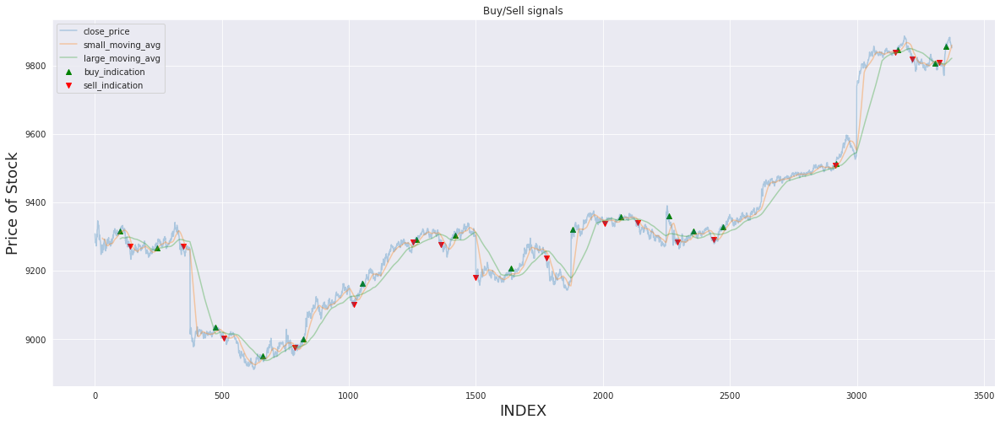

In [52]:
plt.figure(figsize=(20,8))
plt.title('Buy/Sell signals')

plt.scatter(nifty_50_april.index, nifty_50_april['buy_at_price'], color='green', marker='^')
plt.scatter(nifty_50_april.index, nifty_50_april['sell_at_price'], color='red', marker='v')
plt.plot(nifty_50_april.index, nifty_50_april.close_price, alpha=0.3)
plt.plot(nifty_50_april.index, nifty_50_april.small_ma, alpha=0.35)
plt.plot(nifty_50_april.index, nifty_50_april.large_ma, alpha=0.35)

plt.xlabel('INDEX', fontsize=18)
plt.ylabel('Price of Stock', fontsize=18)

plt.legend(['close_price','small_moving_avg','large_moving_avg', 'buy_indication', 'sell_indication'], loc='upper left');

### Removing data from stock_value df where transactions are not mentioned: i.e neither buying or selling of stock taking place.

In [53]:
nifty_50_april = nifty_50_april.loc[nifty_50_april['buy_at_price'].notnull() | nifty_50_april['sell_at_price'].notnull()] 
nifty_50_april = nifty_50_april.reset_index(drop=True, inplace=False)
nifty_50_april

,timestamp,open_price,high_price,low_price,close_price,volume,month,small_ma,large_ma,buy_at_price,sell_at_price
0,2020-04-20 10:54:00+05:30,9317.20,9318.45,9313.20,9315.60,0,4,9310.853333,9293.6375,9315.60,NaN
1,2020-04-20 11:32:00+05:30,9270.15,9273.65,9269.65,9271.60,0,4,9297.398333,9298.2075,NaN,9271.60
2,2020-04-20 13:20:00+05:30,9270.00,9270.95,9267.25,9267.90,0,4,9263.535000,9263.2480,9267.90,NaN
3,2020-04-20 15:03:00+05:30,9269.80,9273.65,9266.75,9270.60,0,4,9290.095000,9290.4155,NaN,9270.60
4,2020-04-21 10:53:00+05:30,9031.35,9037.00,9029.30,9035.50,0,4,9019.711667,9018.1870,9035.50,NaN
5,2020-04-21 11:29:00+05:30,9007.00,9007.10,9002.25,9002.75,0,4,9018.706667,9019.2440,NaN,9002.75
6,2020-04-21 13:59:00+05:30,8944.55,8953.00,8944.40,8951.90,0,4,8943.071667,8941.7135,8951.90,NaN
7,2020-04-22 09:53:00+05:30,8971.80,8980.05,8971.80,8976.90,0,4,8977.160000,8977.4465,NaN,8976.90
8,2020-04-22 10:25:00+05:30,8998.20,9000.00,8990.85,9000.00,0,4,8982.396667,8982.2140,9000.00,NaN
9,2020-04-22 13:46:00+05:30,9101.75,9106.10,9100.65,9100.65,0,4,9125.075000,9125.7775,NaN,9100.65


In [54]:
nifty_50_april

,timestamp,open_price,high_price,low_price,close_price,volume,month,small_ma,large_ma,buy_at_price,sell_at_price
0,2020-04-20 10:54:00+05:30,9317.20,9318.45,9313.20,9315.60,0,4,9310.853333,9293.6375,9315.60,NaN
1,2020-04-20 11:32:00+05:30,9270.15,9273.65,9269.65,9271.60,0,4,9297.398333,9298.2075,NaN,9271.60
2,2020-04-20 13:20:00+05:30,9270.00,9270.95,9267.25,9267.90,0,4,9263.535000,9263.2480,9267.90,NaN
3,2020-04-20 15:03:00+05:30,9269.80,9273.65,9266.75,9270.60,0,4,9290.095000,9290.4155,NaN,9270.60
4,2020-04-21 10:53:00+05:30,9031.35,9037.00,9029.30,9035.50,0,4,9019.711667,9018.1870,9035.50,NaN
5,2020-04-21 11:29:00+05:30,9007.00,9007.10,9002.25,9002.75,0,4,9018.706667,9019.2440,NaN,9002.75
6,2020-04-21 13:59:00+05:30,8944.55,8953.00,8944.40,8951.90,0,4,8943.071667,8941.7135,8951.90,NaN
7,2020-04-22 09:53:00+05:30,8971.80,8980.05,8971.80,8976.90,0,4,8977.160000,8977.4465,NaN,8976.90
8,2020-04-22 10:25:00+05:30,8998.20,9000.00,8990.85,9000.00,0,4,8982.396667,8982.2140,9000.00,NaN
9,2020-04-22 13:46:00+05:30,9101.75,9106.10,9100.65,9100.65,0,4,9125.075000,9125.7775,NaN,9100.65


#### We now, have got table with timestamps of places we are buying or selling.

### Calculating, Profit.
* Trying to calculate Profit for our generated BUY/SELL decision.
* I will try to create a transaction table for our overall profit calculating process.

### Transaction table requirements:
 coloumns{'scrip_id', timestamp, 'buy/sell', 'price', 'quantity',profit, cum_profit, proft_percent}



In [55]:
tt_coloumns = {
    'close_price' : nifty_50_april.close_price,
    'timestamp': nifty_50_april.timestamp,
    'profit':0.0,
    'profit_pct':0.0
}

In [56]:
transaction_table = pd.DataFrame(tt_coloumns)
transaction_table

,close_price,timestamp,profit,profit_pct
0,9315.60,2020-04-20 10:54:00+05:30,0.0,0.0
1,9271.60,2020-04-20 11:32:00+05:30,0.0,0.0
2,9267.90,2020-04-20 13:20:00+05:30,0.0,0.0
3,9270.60,2020-04-20 15:03:00+05:30,0.0,0.0
4,9035.50,2020-04-21 10:53:00+05:30,0.0,0.0
5,9002.75,2020-04-21 11:29:00+05:30,0.0,0.0
6,8951.90,2020-04-21 13:59:00+05:30,0.0,0.0
7,8976.90,2020-04-22 09:53:00+05:30,0.0,0.0
8,9000.00,2020-04-22 10:25:00+05:30,0.0,0.0
9,9100.65,2020-04-22 13:46:00+05:30,0.0,0.0


In [57]:
nifty_50_april

,timestamp,open_price,high_price,low_price,close_price,volume,month,small_ma,large_ma,buy_at_price,sell_at_price
0,2020-04-20 10:54:00+05:30,9317.20,9318.45,9313.20,9315.60,0,4,9310.853333,9293.6375,9315.60,NaN
1,2020-04-20 11:32:00+05:30,9270.15,9273.65,9269.65,9271.60,0,4,9297.398333,9298.2075,NaN,9271.60
2,2020-04-20 13:20:00+05:30,9270.00,9270.95,9267.25,9267.90,0,4,9263.535000,9263.2480,9267.90,NaN
3,2020-04-20 15:03:00+05:30,9269.80,9273.65,9266.75,9270.60,0,4,9290.095000,9290.4155,NaN,9270.60
4,2020-04-21 10:53:00+05:30,9031.35,9037.00,9029.30,9035.50,0,4,9019.711667,9018.1870,9035.50,NaN
5,2020-04-21 11:29:00+05:30,9007.00,9007.10,9002.25,9002.75,0,4,9018.706667,9019.2440,NaN,9002.75
6,2020-04-21 13:59:00+05:30,8944.55,8953.00,8944.40,8951.90,0,4,8943.071667,8941.7135,8951.90,NaN
7,2020-04-22 09:53:00+05:30,8971.80,8980.05,8971.80,8976.90,0,4,8977.160000,8977.4465,NaN,8976.90
8,2020-04-22 10:25:00+05:30,8998.20,9000.00,8990.85,9000.00,0,4,8982.396667,8982.2140,9000.00,NaN
9,2020-04-22 13:46:00+05:30,9101.75,9106.10,9100.65,9100.65,0,4,9125.075000,9125.7775,NaN,9100.65


Seperating column for Buy_Sell decision as one.

In [58]:
buy_sell = pd.Series(nifty_50_april['buy_at_price'].notnull())
buy_sell = buy_sell.replace({True:"Buy", False:"Sell"})
buy_sell

0      Buy
1     Sell
2      Buy
3     Sell
4      Buy
5     Sell
6      Buy
7     Sell
8      Buy
9     Sell
10     Buy
11    Sell
12     Buy
13    Sell
14     Buy
15    Sell
16     Buy
17    Sell
18     Buy
19    Sell
20     Buy
21    Sell
22     Buy
23    Sell
24     Buy
25    Sell
26     Buy
27    Sell
28     Buy
29    Sell
30     Buy
31    Sell
32     Buy
33    Sell
34     Buy
Name: buy_at_price, dtype: object

In [59]:
nifty_50_april = nifty_50_april.drop('buy_at_price', axis=1)
nifty_50_april = nifty_50_april.drop('sell_at_price', axis=1)
nifty_50_april['buy_sell'] = buy_sell
nifty_50_april

,timestamp,open_price,high_price,low_price,close_price,volume,month,small_ma,large_ma,buy_sell
0,2020-04-20 10:54:00+05:30,9317.20,9318.45,9313.20,9315.60,0,4,9310.853333,9293.6375,Buy
1,2020-04-20 11:32:00+05:30,9270.15,9273.65,9269.65,9271.60,0,4,9297.398333,9298.2075,Sell
2,2020-04-20 13:20:00+05:30,9270.00,9270.95,9267.25,9267.90,0,4,9263.535000,9263.2480,Buy
3,2020-04-20 15:03:00+05:30,9269.80,9273.65,9266.75,9270.60,0,4,9290.095000,9290.4155,Sell
4,2020-04-21 10:53:00+05:30,9031.35,9037.00,9029.30,9035.50,0,4,9019.711667,9018.1870,Buy
5,2020-04-21 11:29:00+05:30,9007.00,9007.10,9002.25,9002.75,0,4,9018.706667,9019.2440,Sell
6,2020-04-21 13:59:00+05:30,8944.55,8953.00,8944.40,8951.90,0,4,8943.071667,8941.7135,Buy
7,2020-04-22 09:53:00+05:30,8971.80,8980.05,8971.80,8976.90,0,4,8977.160000,8977.4465,Sell
8,2020-04-22 10:25:00+05:30,8998.20,9000.00,8990.85,9000.00,0,4,8982.396667,8982.2140,Buy
9,2020-04-22 13:46:00+05:30,9101.75,9106.10,9100.65,9100.65,0,4,9125.075000,9125.7775,Sell


Reordering the Table for Clearer analysis.

In [60]:
nifty_50_april = nifty_50_april[["timestamp","close_price","buy_sell"]]
nifty_50_april

,timestamp,close_price,buy_sell
0,2020-04-20 10:54:00+05:30,9315.60,Buy
1,2020-04-20 11:32:00+05:30,9271.60,Sell
2,2020-04-20 13:20:00+05:30,9267.90,Buy
3,2020-04-20 15:03:00+05:30,9270.60,Sell
4,2020-04-21 10:53:00+05:30,9035.50,Buy
5,2020-04-21 11:29:00+05:30,9002.75,Sell
6,2020-04-21 13:59:00+05:30,8951.90,Buy
7,2020-04-22 09:53:00+05:30,8976.90,Sell
8,2020-04-22 10:25:00+05:30,9000.00,Buy
9,2020-04-22 13:46:00+05:30,9100.65,Sell


### This is the table we will require for our transaction table!

In [61]:
transaction_table['buy_sell'] = nifty_50_april.buy_sell
transaction_table['qty'] = 0
transaction_table = transaction_table[["timestamp","close_price","buy_sell","qty","profit", "profit_pct"]]
transaction_table

,timestamp,close_price,buy_sell,qty,profit,profit_pct
0,2020-04-20 10:54:00+05:30,9315.60,Buy,0,0.0,0.0
1,2020-04-20 11:32:00+05:30,9271.60,Sell,0,0.0,0.0
2,2020-04-20 13:20:00+05:30,9267.90,Buy,0,0.0,0.0
3,2020-04-20 15:03:00+05:30,9270.60,Sell,0,0.0,0.0
4,2020-04-21 10:53:00+05:30,9035.50,Buy,0,0.0,0.0
5,2020-04-21 11:29:00+05:30,9002.75,Sell,0,0.0,0.0
6,2020-04-21 13:59:00+05:30,8951.90,Buy,0,0.0,0.0
7,2020-04-22 09:53:00+05:30,8976.90,Sell,0,0.0,0.0
8,2020-04-22 10:25:00+05:30,9000.00,Buy,0,0.0,0.0
9,2020-04-22 13:46:00+05:30,9100.65,Sell,0,0.0,0.0


In [62]:
def get_transaction_table(df):
    for i in range(0,len(df)):
        if i>0:
            df['qty'][i] = df['qty'][i-1]
        if (df['buy_sell'][i] == 'Buy'):
            df['qty'][i] = df['qty'][i] + 1
        else:
            df['qty'][i] = df['qty'][i] - 1
        if(i%2 != 0):
            if df['buy_sell'][i] == 'Sell':
                df['profit'][i] = df['close_price'][i] - df['close_price'][i-1]
            else:
                df['profit'][i] = df['close_price'][i-1] - df['close_price'][i]    
        else:
            df['profit'][i] = 0
            
    for i in range(1,len(df)):
        df['profit_pct'][i] = (df['profit'][i] / df['close_price'][i]) * 100
    
    return df

# Transaction Table.

In [63]:
transaction_table = get_transaction_table(transaction_table)
transaction_table

/opt/conda/lib/python3.7/site-packages/ipykernel_launcher.py:9: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  if __name__ == '__main__':
/opt/conda/lib/python3.7/site-packages/ipykernel_launcher.py:1: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  """Entry point for launching an IPython kernel.
/opt/conda/lib/python3.7/site-packages/ipykernel_launcher.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
/opt/conda/lib/python3.7/site-packa

,timestamp,close_price,buy_sell,qty,profit,profit_pct
0,2020-04-20 10:54:00+05:30,9315.60,Buy,1,0.00,0.000000
1,2020-04-20 11:32:00+05:30,9271.60,Sell,0,-44.00,-0.474567
2,2020-04-20 13:20:00+05:30,9267.90,Buy,1,0.00,0.000000
3,2020-04-20 15:03:00+05:30,9270.60,Sell,0,2.70,0.029124
4,2020-04-21 10:53:00+05:30,9035.50,Buy,1,0.00,0.000000
5,2020-04-21 11:29:00+05:30,9002.75,Sell,0,-32.75,-0.363778
6,2020-04-21 13:59:00+05:30,8951.90,Buy,1,0.00,0.000000
7,2020-04-22 09:53:00+05:30,8976.90,Sell,0,25.00,0.278493
8,2020-04-22 10:25:00+05:30,9000.00,Buy,1,0.00,0.000000
9,2020-04-22 13:46:00+05:30,9100.65,Sell,0,100.65,1.105965


### Visualizing the above transaction data frame.

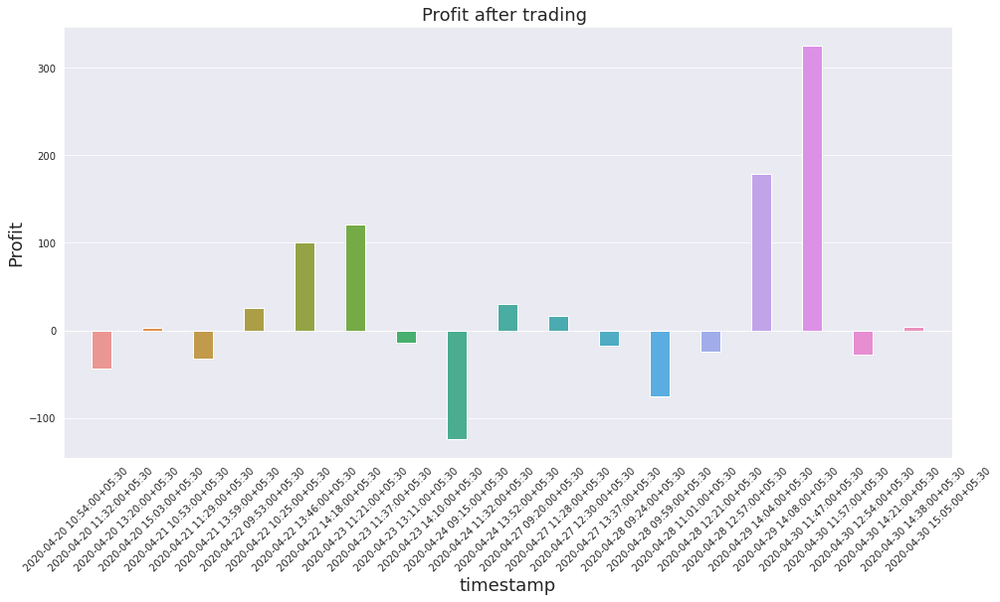

In [64]:
plt.figure(figsize=(16,8))
plt.title('Profit after trading ', fontsize=18)

sns.barplot(transaction_table.timestamp, transaction_table.profit)

plt.xticks(rotation = 45)
plt.ylabel('Profit', fontsize=18)
plt.xlabel('timestamp', fontsize=18);